# Differentially expressed gene analysis on super-boundaries

In [1]:
#load packages
library(Seurat)
library(ggplot2)
library(magrittr)
library(data.table)
library(Matrix)
library(dplyr)
library(tibble)
library(MAST)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following object is masked from ‘package:dplyr’:

    count



Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
 

In [2]:
#load data
seu_PR <- readRDS(file = "../../data/seurat_object/Set3/seu_lateralect_PR_ID.obj")

In [3]:
seu_PR

An object of class Seurat 
28745 features across 1717 samples within 2 assays 
Active assay: SCT (11239 features, 2000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, reumap

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”


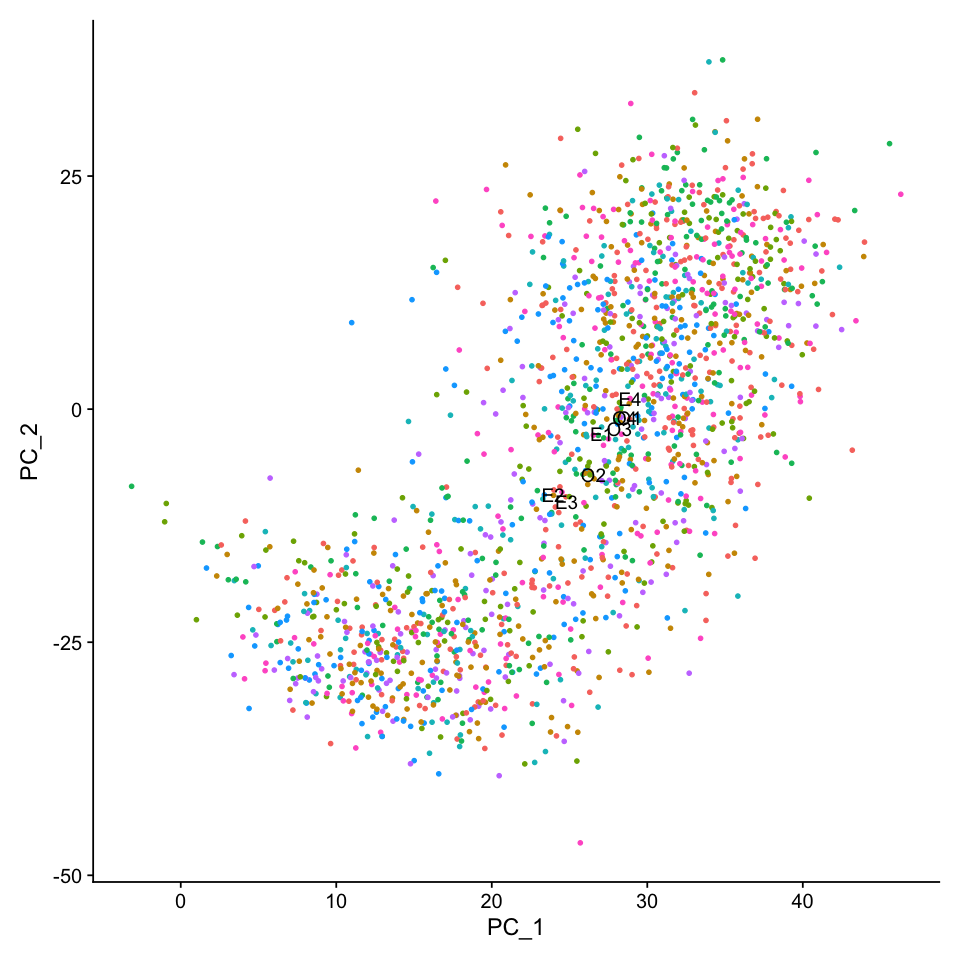

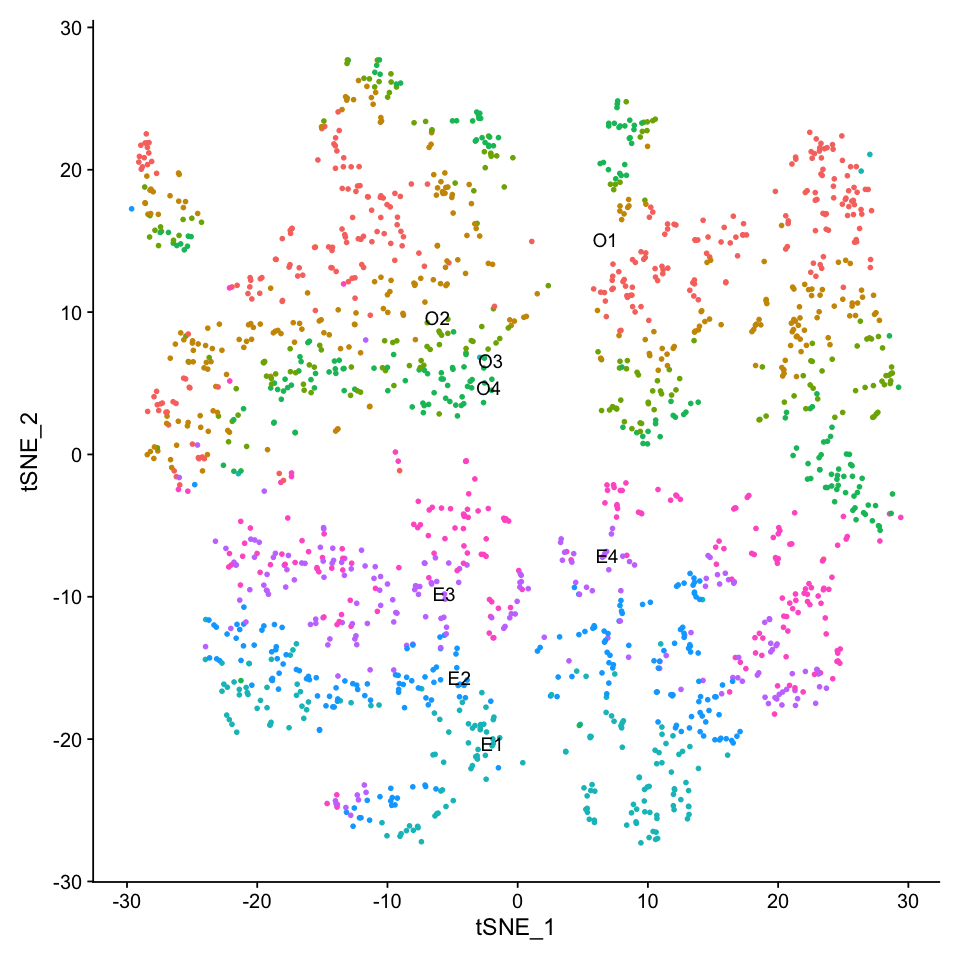

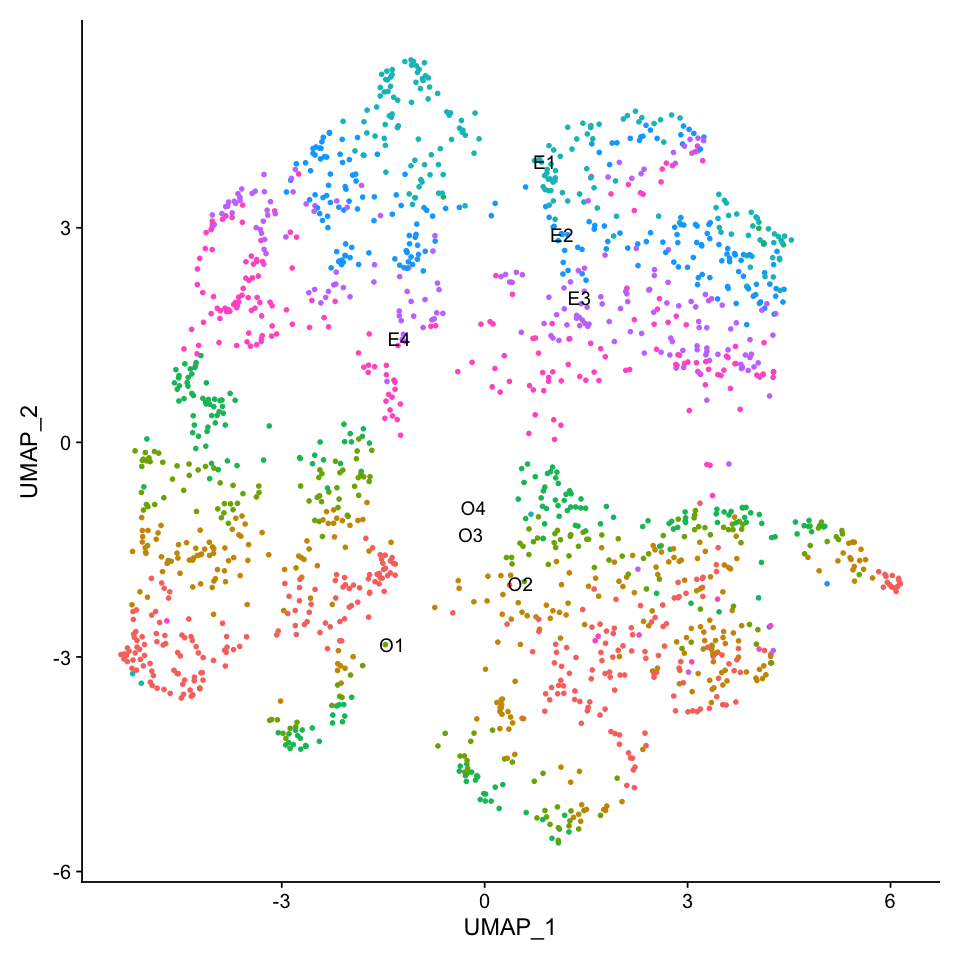

In [4]:
options(repr.plot.width=8, repr.plot.height=8)
seu_PR <- RunPCA(seu_PR, verbose = FALSE)
seu_PR <- RunTSNE(seu_PR, dims = 1:30, verbose = FALSE)
seu_PR <- RunUMAP(seu_PR, dims = 1:30, verbose = FALSE)
DimPlot(seu_PR, reduction =  "pca", label = TRUE) + NoLegend()
DimPlot(seu_PR, reduction =  "tsne", label = TRUE) + NoLegend()
DimPlot(seu_PR, reduction =  "umap", label = TRUE) + NoLegend()

## DEG analysis

In [5]:
Idents(seu_PR) <- "pairrule_ID"

In [6]:
levels <- c("O1","O2","O3","O4", "E1","E2","E3","E4")
levels(seu_PR) <- levels

In [7]:
seu_PR_VF3000 <- seu_PR[VariableFeatures(seu_PR), ]
seu_PR_VF3000

An object of class Seurat 
4000 features across 1717 samples within 2 assays 
Active assay: SCT (2000 features, 2000 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, umap, reumap, tsne

### O1 vs. O3


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
pxb,2.089813e-143,2.1899253,1.000,0.354,4.179627e-140,O1vsO3
hh,1.917854e-138,2.3203573,0.996,0.053,3.835708e-135,O1vsO3
eve,5.478680e-109,2.2680469,0.989,0.455,1.095736e-105,O1vsO3
mid,8.744809e-107,1.8990632,0.965,0.328,1.748962e-103,O1vsO3
run,8.007395e-105,-1.9959873,0.302,0.989,1.601479e-101,O1vsO3
en,2.683831e-100,1.9535365,0.944,0.095,5.367663e-97,O1vsO3
Tollo,2.850648e-98,1.1862407,1.000,0.963,5.701296e-95,O1vsO3
slp1,1.581620e-97,-1.9855340,0.330,0.979,3.163240e-94,O1vsO3
comm,9.041898e-90,-1.8895844,0.253,0.937,1.808380e-86,O1vsO3


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
pxb,2.089813e-143,2.1899253,1.000,0.354,4.179627e-140
hh,1.917854e-138,2.3203573,0.996,0.053,3.835708e-135
eve,5.478680e-109,2.2680469,0.989,0.455,1.095736e-105
mid,8.744809e-107,1.8990632,0.965,0.328,1.748962e-103
en,2.683831e-100,1.9535365,0.944,0.095,5.367663e-97
Tollo,2.850648e-98,1.1862407,1.000,0.963,5.701296e-95
gsb,9.165330e-68,2.3132185,0.814,0.085,1.833066e-64
rdx,7.800183e-59,0.8305945,1.000,0.989,1.560037e-55
pri,1.606899e-52,1.6484577,0.909,0.455,3.213798e-49


[1] 13  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
run,8.007395e-105,-1.9959873,0.302,0.989,1.601479e-101
slp1,1.581620e-97,-1.9855340,0.330,0.979,3.163240e-94
comm,9.041898e-90,-1.8895844,0.253,0.937,1.808380e-86
comm2,9.371071e-68,-1.2020814,0.084,0.804,1.874214e-64
pio,1.298584e-25,-0.8958120,0.396,0.767,2.597169e-22
Toll-6,2.533367e-23,-0.9460775,0.863,0.958,5.066735e-20
CG15480,1.390211e-20,-0.9307150,0.670,0.910,2.780422e-17
grn,2.921675e-08,-0.8141602,0.074,0.249,5.843350e-05
CG12986,5.856826e-07,-0.7531491,0.204,0.381,1.171365e-03


[1] 10  5

[1] "DEGs O1vsO3, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs O1vsO3, avgFC <= -1.5, FWER <= 0.01"

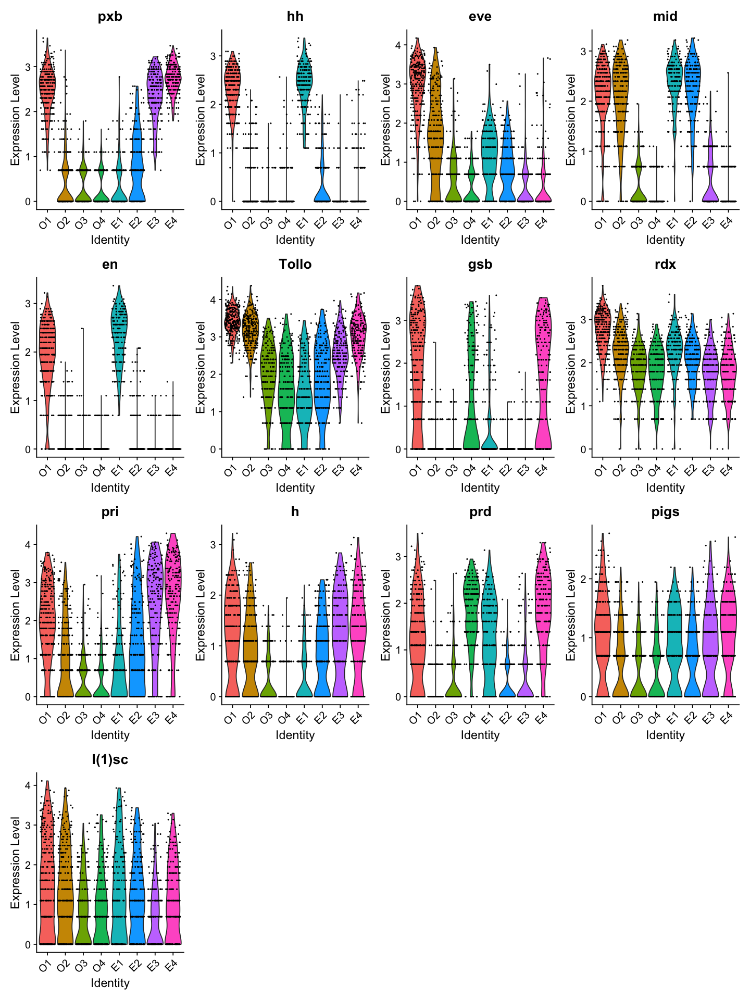

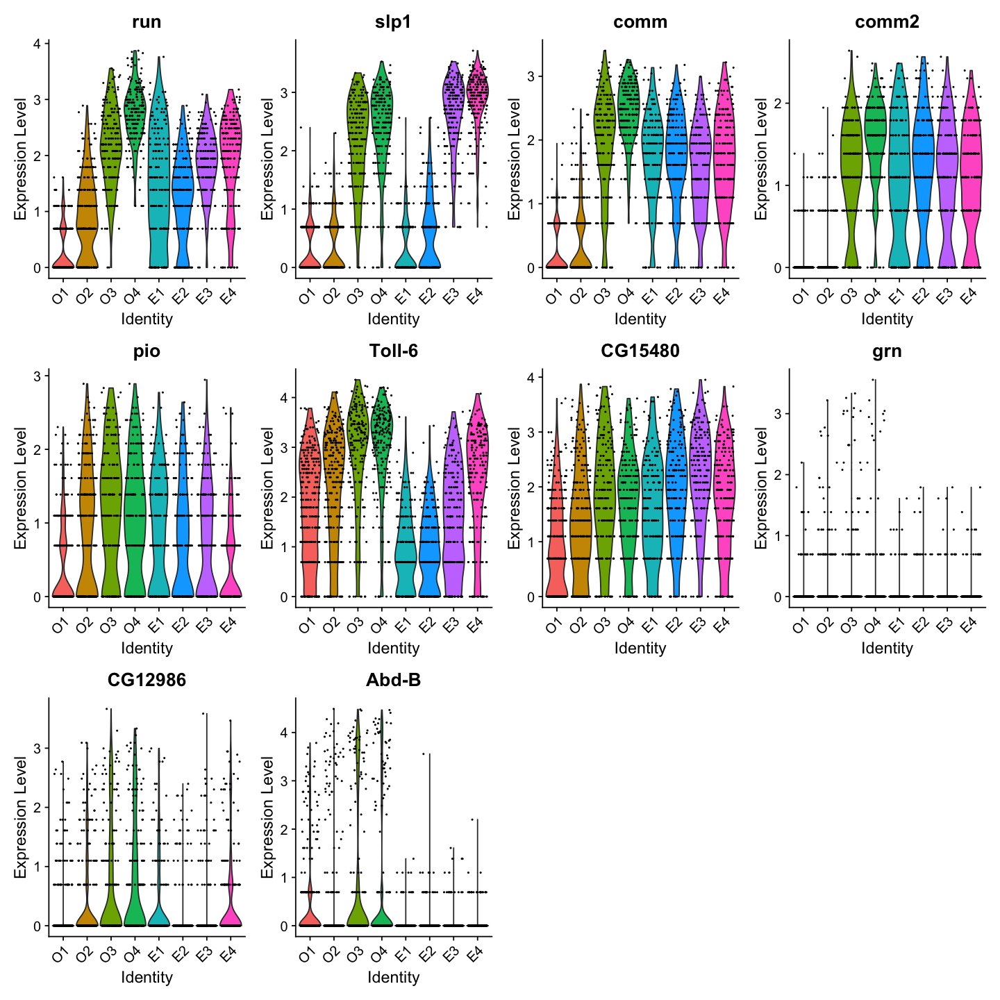

In [8]:
DE_O1vsO3 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O1",
  ident.2 = "O3",
  logfc.threshold = log(2.0),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O1vsO3_FWER0.01_FC2.0 <- filter(DE_O1vsO3, p_val_adj <= 0.01)

compaired_ID <- rep("O1vsO3", length=nrow(DE_O1vsO3_FWER0.01_FC2.0)) 
DE_O1vsO3_FWER0.01_FC2.0 <- cbind(DE_O1vsO3_FWER0.01_FC2.0, compaired_ID)
DE_O1vsO3_FWER0.01_FC2.0

DE_O1vsO3_FWER0.01_FC2.0_plus <- filter(DE_O1vsO3, p_val_adj <= 0.01 & avg_logFC >= log(2.0) )
DE_O1vsO3_FWER0.01_FC2.0_plus
dim(DE_O1vsO3_FWER0.01_FC2.0_plus)
DE_O1vsO3_FWER0.01_FC2.0_minus <- filter(DE_O1vsO3, p_val_adj <= 0.01 & avg_logFC <= -log(2.0) )
DE_O1vsO3_FWER0.01_FC2.0_minus
dim(DE_O1vsO3_FWER0.01_FC2.0_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O1vsO3_FWER0.01_FC2.0_plus)/4))
"DEGs O1vsO3, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O1vsO3_FWER0.01_FC2.0_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_O1vsO3_plus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O1vsO3_FWER0.01_FC2.0_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O1vsO3_FWER0.01_FC2.0_minus)/4))
"DEGs O1vsO3, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O1vsO3_FWER0.01_FC2.0_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_O1vsO3_minus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O1vsO3_FWER0.01_FC2.0_minus)/4))

write.table(DE_O1vsO3_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_O1vsO3_FWER0.01_FC2.0.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### O2 vs. O4


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
wg,3.926169e-126,-2.1947538,0.069,0.995,7.852337e-123,O2vsO4
comm,7.917278e-124,-1.8901320,0.406,1.000,1.583456e-120,O2vsO4
odd,5.248627e-116,1.8238289,0.973,0.230,1.049725e-112,O2vsO4
run,2.788831e-115,-1.6904059,0.713,1.000,5.577663e-112,O2vsO4
slp1,8.742724e-113,-2.0952301,0.375,0.975,1.748545e-109,O2vsO4
mid,5.630559e-109,2.0770401,0.973,0.176,1.126112e-105,O2vsO4
18w,2.727069e-104,-1.7029283,0.575,0.985,5.454139e-101,O2vsO4
comm2,5.860127e-96,-1.4191207,0.157,0.966,1.172025e-92,O2vsO4
prd,4.252309e-90,-1.6642258,0.226,0.966,8.504617e-87,O2vsO4


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
odd,5.248627e-116,1.8238289,0.973,0.230,1.049725e-112
mid,5.630559e-109,2.0770401,0.973,0.176,1.126112e-105
Tollo,1.533962e-84,1.2744213,1.000,0.858,3.067925e-81
sob,2.809520e-75,1.2704703,0.889,0.123,5.619039e-72
drm,3.728240e-71,1.2117757,0.916,0.201,7.456479e-68
eve,1.748777e-46,1.7257007,0.835,0.377,3.497555e-43
h,2.811430e-34,0.9744181,0.705,0.181,5.622859e-31
toc,1.717586e-24,1.2422441,0.724,0.324,3.435171e-21
upd1,4.496312e-21,0.8522119,0.410,0.059,8.992625e-18


[1] 12  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
wg,3.926169e-126,-2.1947538,0.069,0.995,7.852337e-123
comm,7.917278e-124,-1.8901320,0.406,1.000,1.583456e-120
run,2.788831e-115,-1.6904059,0.713,1.000,5.577663e-112
slp1,8.742724e-113,-2.0952301,0.375,0.975,1.748545e-109
18w,2.727069e-104,-1.7029283,0.575,0.985,5.454139e-101
comm2,5.860127e-96,-1.4191207,0.157,0.966,1.172025e-92
prd,4.252309e-90,-1.6642258,0.226,0.966,8.504617e-87
slp2,4.205525e-48,-0.9101337,0.046,0.642,8.411049e-45
gsb,9.554917e-32,-1.6531197,0.123,0.554,1.910983e-28


[1] 10  5

[1] "DEGs O2vsO4, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs O2vsO4, avgFC <= -1.5, FWER <= 0.01"

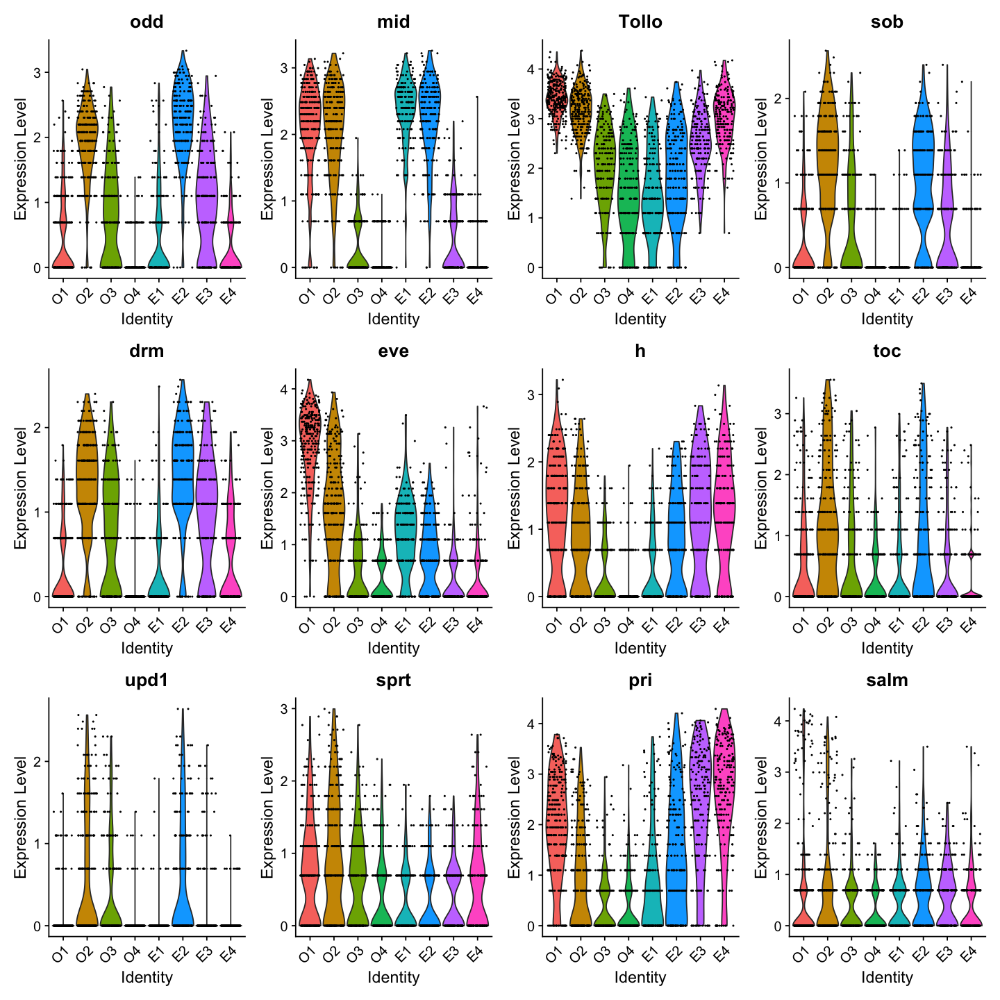

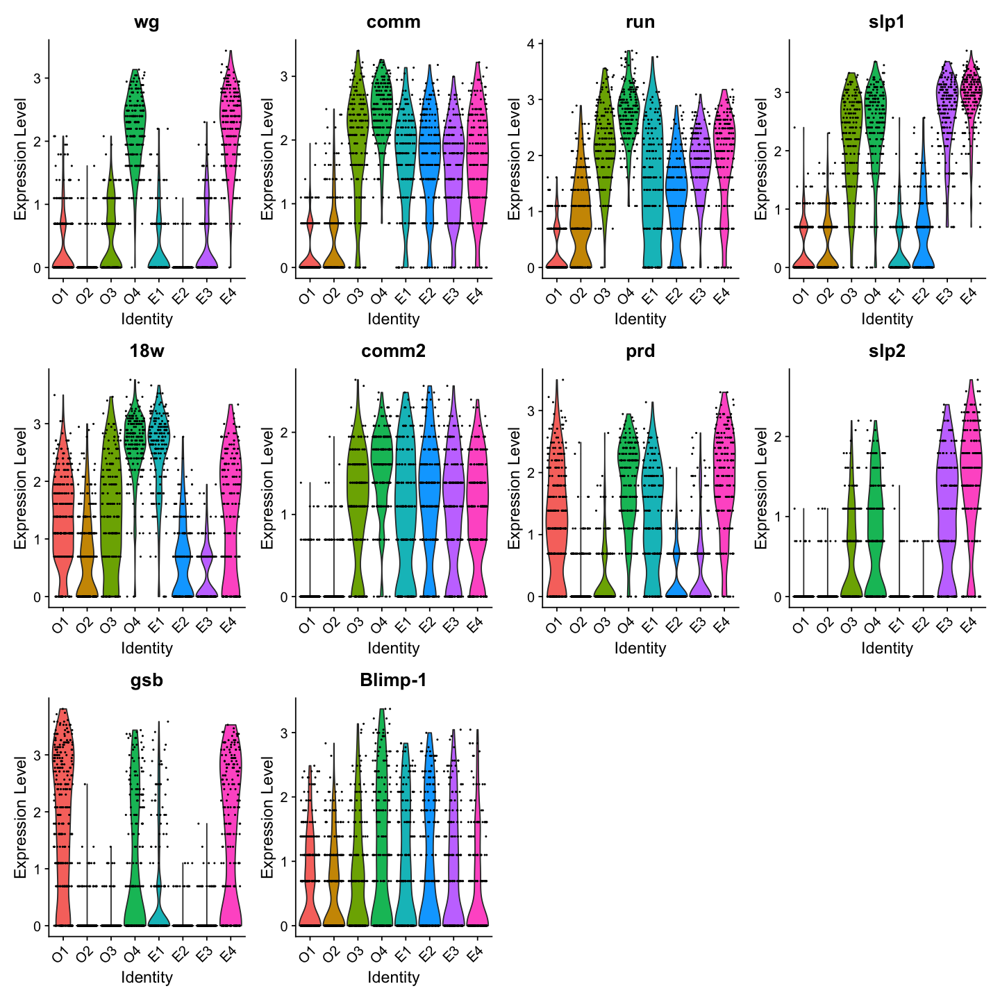

In [9]:
DE_O2vsO4 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O2",
  ident.2 = "O4",
  logfc.threshold = log(2.0),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O2vsO4_FWER0.01_FC2.0 <- filter(DE_O2vsO4, p_val_adj <= 0.01)

compaired_ID <- rep("O2vsO4", length=nrow(DE_O2vsO4_FWER0.01_FC2.0)) 
DE_O2vsO4_FWER0.01_FC2.0 <- cbind(DE_O2vsO4_FWER0.01_FC2.0, compaired_ID)
DE_O2vsO4_FWER0.01_FC2.0

DE_O2vsO4_FWER0.01_FC2.0_plus <- filter(DE_O2vsO4, p_val_adj <= 0.01 & avg_logFC >= log(2.0) )
DE_O2vsO4_FWER0.01_FC2.0_plus
dim(DE_O2vsO4_FWER0.01_FC2.0_plus)
DE_O2vsO4_FWER0.01_FC2.0_minus <- filter(DE_O2vsO4, p_val_adj <= 0.01 & avg_logFC <= -log(2.0) )
DE_O2vsO4_FWER0.01_FC2.0_minus
dim(DE_O2vsO4_FWER0.01_FC2.0_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O2vsO4_FWER0.01_FC2.0_plus)/4))
"DEGs O2vsO4, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O2vsO4_FWER0.01_FC2.0_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_O2vsO4_plus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O2vsO4_FWER0.01_FC2.0_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O2vsO4_FWER0.01_FC2.0_minus)/4))
"DEGs O2vsO4, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O2vsO4_FWER0.01_FC2.0_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_O2vsO4_minus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O2vsO4_FWER0.01_FC2.0_minus)/4))

write.table(DE_O2vsO4_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_O2vsO4_FWER0.01_FC2.0.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)





### O3 vs. E1


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,1.261260e-151,-2.6263970,0.831,1.000,2.522520e-148,O3vsE1
ftz,6.190412e-128,-2.6116275,0.302,1.000,1.238082e-124,O3vsE1
mid,1.356877e-110,-2.0746863,0.328,0.994,2.713754e-107,O3vsE1
hh,2.457590e-110,-2.4218866,0.053,1.000,4.915180e-107,O3vsE1
en,6.271648e-104,-2.2931649,0.095,1.000,1.254330e-100,O3vsE1
slp1,2.574672e-72,1.9291527,0.979,0.328,5.149344e-69,O3vsE1
Toll-6,1.030573e-53,1.8957931,0.958,0.712,2.061146e-50,O3vsE1
ImpL2,4.475913e-43,1.2468863,1.000,0.966,8.951827e-40,O3vsE1
18w,5.012984e-30,-0.8621948,0.831,0.977,1.002597e-26,O3vsE1


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,2.574672e-72,1.9291527,0.979,0.328,5.149344e-69
Toll-6,1.030573e-53,1.8957931,0.958,0.712,2.061146e-50
ImpL2,4.475913e-43,1.2468863,1.000,0.966,8.951827e-40
ich,1.290938e-27,1.2496012,0.884,0.525,2.581876e-24
dally,1.310606e-23,0.7433968,0.942,0.751,2.621211e-20
Abd-B,1.605308e-13,2.1509810,0.333,0.090,3.210616e-10
Thor,6.941087e-10,0.7780308,0.624,0.452,1.388217e-06
CG17716,7.634301e-10,0.7479136,0.365,0.102,1.526860e-06
mirr,7.864191e-07,0.7301647,0.423,0.186,1.572838e-03


[1] 9 5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,1.261260e-151,-2.6263970,0.831,1.000,2.522520e-148
ftz,6.190412e-128,-2.6116275,0.302,1.000,1.238082e-124
mid,1.356877e-110,-2.0746863,0.328,0.994,2.713754e-107
hh,2.457590e-110,-2.4218866,0.053,1.000,4.915180e-107
en,6.271648e-104,-2.2931649,0.095,1.000,1.254330e-100
18w,5.012984e-30,-0.8621948,0.831,0.977,1.002597e-26
prd,6.390307e-29,-1.0805371,0.280,0.791,1.278061e-25
CG4702,2.526120e-18,-1.2002856,0.164,0.554,5.052239e-15
CG10479,2.000266e-16,-0.8461461,0.571,0.825,4.000532e-13


[1] 13  5

[1] "DEGs O3vsE1, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs O3vsE1, avgFC <= -1.5, FWER <= 0.01"

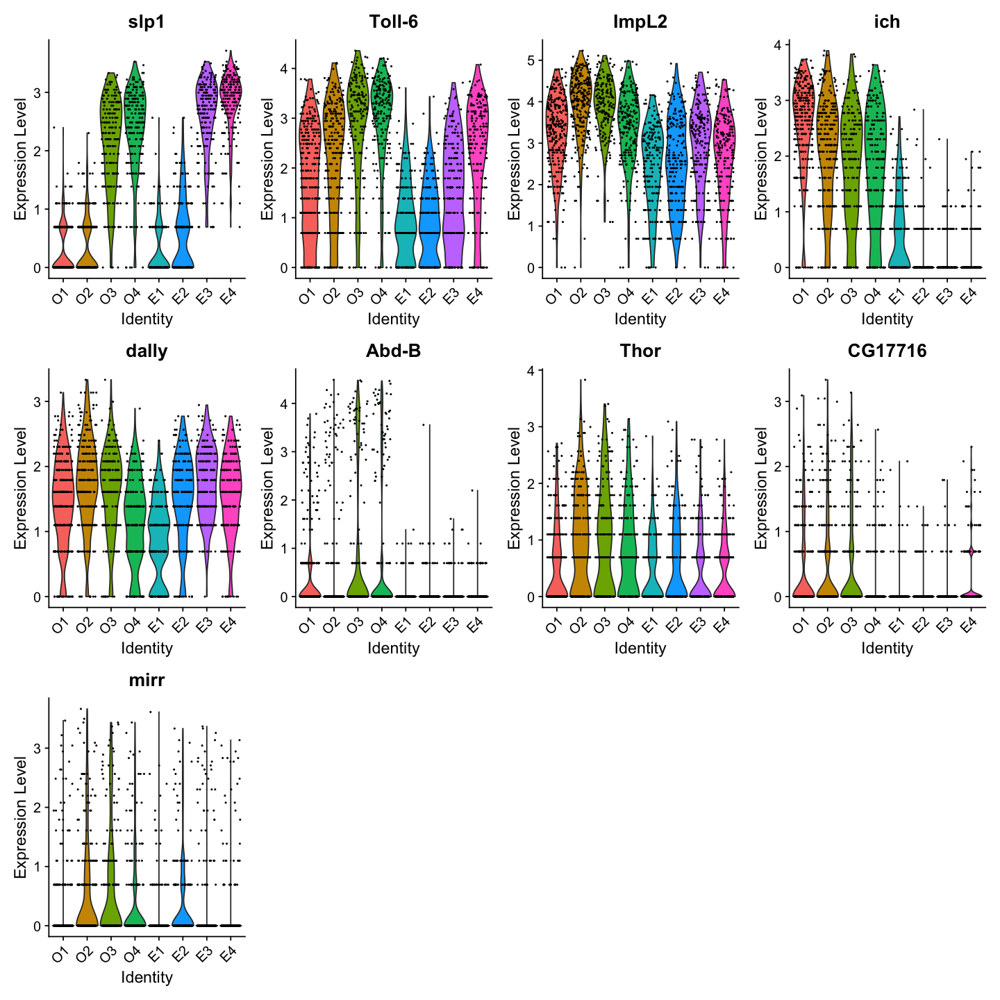

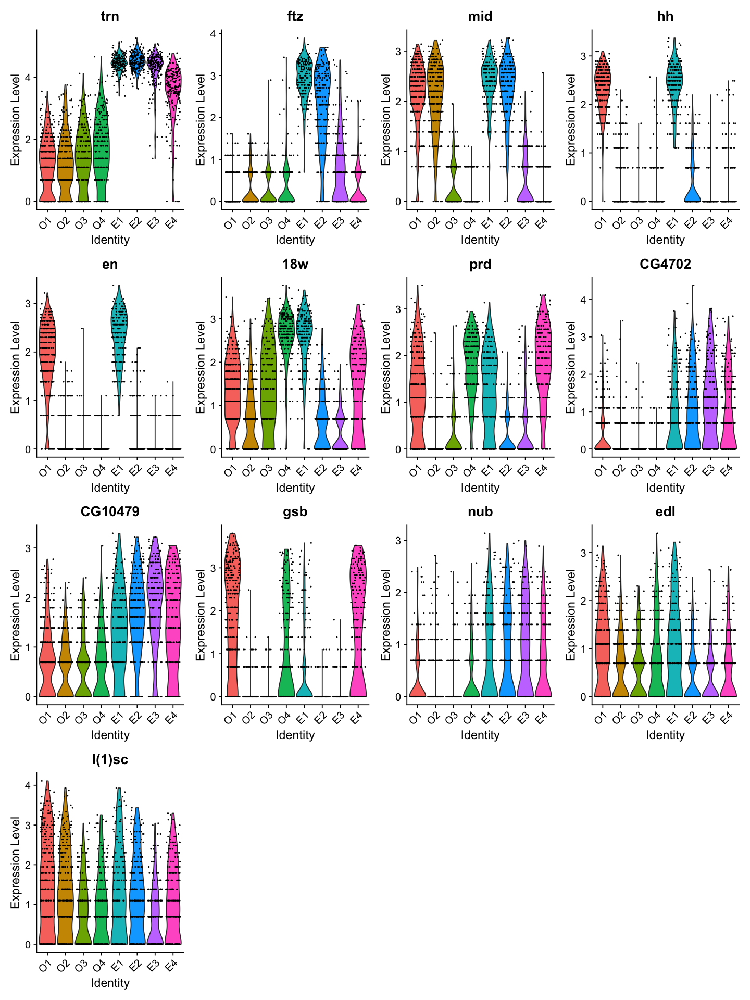

In [10]:
DE_O3vsE1 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O3",
  ident.2 = "E1",
  logfc.threshold = log(2.0),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O3vsE1_FWER0.01_FC2.0 <- filter(DE_O3vsE1, p_val_adj <= 0.01)

compaired_ID <- rep("O3vsE1", length=nrow(DE_O3vsE1_FWER0.01_FC2.0)) 
DE_O3vsE1_FWER0.01_FC2.0 <- cbind(DE_O3vsE1_FWER0.01_FC2.0, compaired_ID)
DE_O3vsE1_FWER0.01_FC2.0

DE_O3vsE1_FWER0.01_FC2.0_plus <- filter(DE_O3vsE1, p_val_adj <= 0.01 & avg_logFC >= log(2.0) )
DE_O3vsE1_FWER0.01_FC2.0_plus
dim(DE_O3vsE1_FWER0.01_FC2.0_plus)
DE_O3vsE1_FWER0.01_FC2.0_minus <- filter(DE_O3vsE1, p_val_adj <= 0.01 & avg_logFC <= -log(2.0) )
DE_O3vsE1_FWER0.01_FC2.0_minus
dim(DE_O3vsE1_FWER0.01_FC2.0_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O3vsE1_FWER0.01_FC2.0_plus)/4))
"DEGs O3vsE1, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O3vsE1_FWER0.01_FC2.0_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_O3vsE1_plus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O3vsE1_FWER0.01_FC2.0_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O3vsE1_FWER0.01_FC2.0_minus)/4))
"DEGs O3vsE1, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O3vsE1_FWER0.01_FC2.0_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_O3vsE1_minus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O3vsE1_FWER0.01_FC2.0_minus)/4))

write.table(DE_O3vsE1_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_O3vsE1_FWER0.01_FC2.0.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### O4 vs. E2


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,2.677261e-144,-2.3143987,0.877,1.000,5.354521e-141,O4vsE2
wg,6.760593e-117,2.2495551,0.995,0.054,1.352119e-113,O4vsE2
mid,1.150452e-111,-2.1966137,0.176,0.990,2.300904e-108,O4vsE2
odd,1.520118e-109,-2.1143079,0.230,0.980,3.040235e-106,O4vsE2
18w,1.491267e-102,1.8191854,0.985,0.567,2.982534e-99,O4vsE2
slp1,1.177251e-82,1.7507723,0.975,0.542,2.354503e-79,O4vsE2
run,5.521328e-82,1.3658455,1.000,0.813,1.104266e-78,O4vsE2
Toll-6,1.192794e-79,1.9803946,0.961,0.714,2.385588e-76,O4vsE2
prd,5.207726e-77,1.6229105,0.966,0.296,1.041545e-73,O4vsE2


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
wg,6.760593e-117,2.2495551,0.995,0.054,1.352119e-113
18w,1.491267e-102,1.8191854,0.985,0.567,2.982534e-99
slp1,1.177251e-82,1.7507723,0.975,0.542,2.354503e-79
run,5.521328e-82,1.3658455,1.000,0.813,1.104266e-78
Toll-6,1.192794e-79,1.9803946,0.961,0.714,2.385588e-76
prd,5.207726e-77,1.6229105,0.966,0.296,1.041545e-73
ich,9.906895e-55,1.8491417,0.853,0.202,1.981379e-51
slp2,1.674918e-40,0.9085821,0.642,0.059,3.349836e-37
halo,1.998410e-39,1.3825932,0.926,0.576,3.996820e-36


[1] 13  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,2.677261e-144,-2.3143987,0.877,1.000,5.354521e-141
mid,1.150452e-111,-2.1966137,0.176,0.990,2.300904e-108
odd,1.520118e-109,-2.1143079,0.230,0.980,3.040235e-106
ftz,4.123732e-72,-2.0023960,0.338,0.936,8.247463e-69
drm,6.579473e-69,-1.3137566,0.201,0.921,1.315895e-65
sob,6.684487e-52,-1.0491411,0.123,0.803,1.336897e-48
5-HT2A,1.116628e-37,-1.0503888,0.554,0.916,2.233255e-34
CG10479,2.420764e-33,-0.9878838,0.593,0.941,4.841529e-30
CG4702,2.630879e-31,-1.4690143,0.152,0.650,5.261758e-28


[1] 17  5

[1] "DEGs O4vsE2, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs O4vsE2, avgFC <= -1.5, FWER <= 0.01"

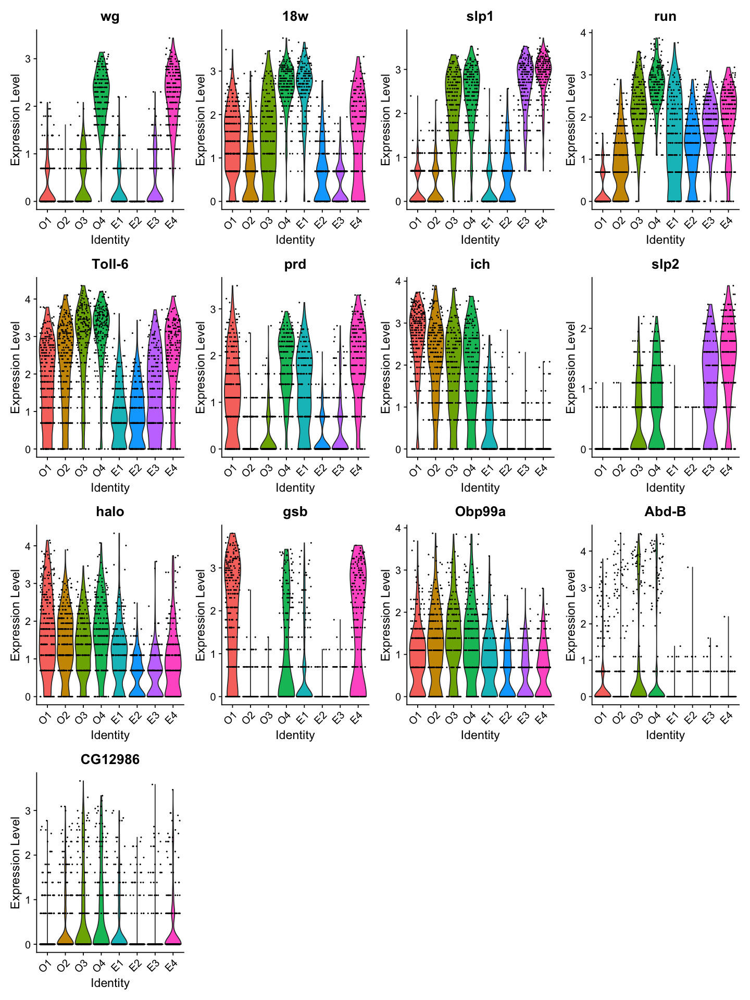

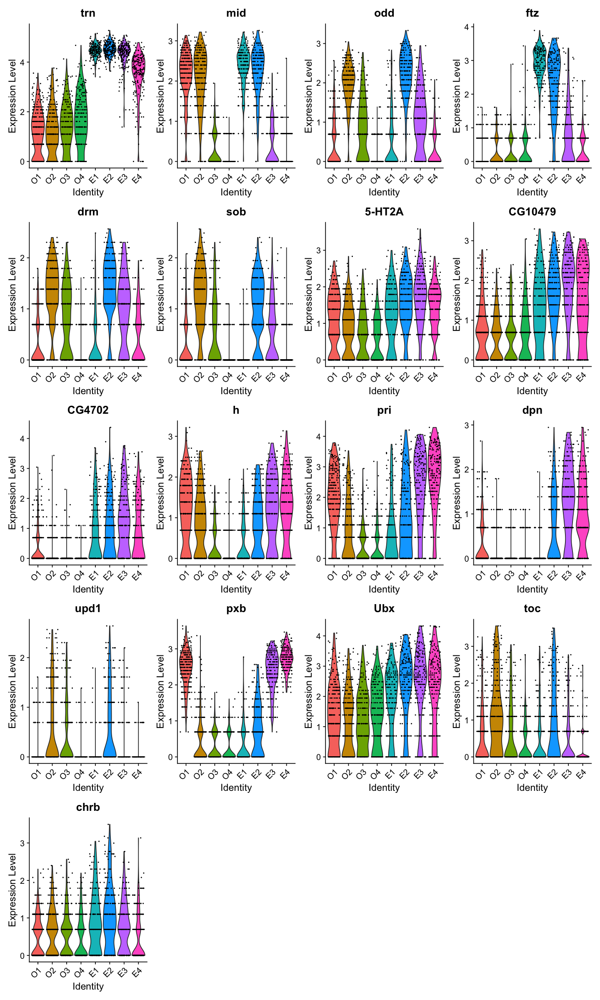

In [11]:
DE_O4vsE2 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "O4",
  ident.2 = "E2",
  logfc.threshold = log(2.0),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_O4vsE2_FWER0.01_FC2.0 <- filter(DE_O4vsE2, p_val_adj <= 0.01)

compaired_ID <- rep("O4vsE2", length=nrow(DE_O4vsE2_FWER0.01_FC2.0)) 
DE_O4vsE2_FWER0.01_FC2.0 <- cbind(DE_O4vsE2_FWER0.01_FC2.0, compaired_ID)
DE_O4vsE2_FWER0.01_FC2.0

DE_O4vsE2_FWER0.01_FC2.0_plus <- filter(DE_O4vsE2, p_val_adj <= 0.01 & avg_logFC >= log(2.0) )
DE_O4vsE2_FWER0.01_FC2.0_plus
dim(DE_O4vsE2_FWER0.01_FC2.0_plus)
DE_O4vsE2_FWER0.01_FC2.0_minus <- filter(DE_O4vsE2, p_val_adj <= 0.01 & avg_logFC <= -log(2.0) )
DE_O4vsE2_FWER0.01_FC2.0_minus
dim(DE_O4vsE2_FWER0.01_FC2.0_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_O4vsE2_FWER0.01_FC2.0_plus)/4))
"DEGs O4vsE2, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O4vsE2_FWER0.01_FC2.0_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_O4vsE2_plus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O4vsE2_FWER0.01_FC2.0_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_O4vsE2_FWER0.01_FC2.0_minus)/4))
"DEGs O4vsE2, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_O4vsE2_FWER0.01_FC2.0_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_O4vsE2_minus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_O4vsE2_FWER0.01_FC2.0_minus)/4))

write.table(DE_O4vsE2_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_O4vsE2_FWER0.01_FC2.0.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### E1 vs. E3


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
en,8.665137e-109,2.3376252,1.000,0.098,1.733027e-105,E1vsE3
hh,3.960418e-106,2.3540319,1.000,0.062,7.920836e-103,E1vsE3
slp1,7.995600e-102,-2.3258984,0.328,1.000,1.599120e-98,E1vsE3
18w,1.707345e-100,2.2113348,0.977,0.418,3.414690e-97,E1vsE3
mid,2.247589e-100,1.8718736,0.994,0.397,4.495179e-97,E1vsE3
pxb,3.967223e-99,-2.0097785,0.328,1.000,7.934446e-96,E1vsE3
ftz,3.570490e-90,1.8008848,1.000,0.567,7.140979e-87,E1vsE3
slp2,7.974131e-51,-1.1812572,0.051,0.763,1.594826e-47,E1vsE3
dpn,4.509575e-49,-1.4311615,0.085,0.789,9.019150e-46,E1vsE3


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
en,8.665137e-109,2.3376252,1.000,0.098,1.733027e-105
hh,3.960418e-106,2.3540319,1.000,0.062,7.920836e-103
18w,1.707345e-100,2.2113348,0.977,0.418,3.414690e-97
mid,2.247589e-100,1.8718736,0.994,0.397,4.495179e-97
ftz,3.570490e-90,1.8008848,1.000,0.567,7.140979e-87
eve,1.642011e-29,0.8852183,0.853,0.351,3.284022e-26
Sema5c,1.765140e-26,0.8491047,0.836,0.423,3.530280e-23
prd,4.921047e-20,0.8206398,0.791,0.361,9.842094e-17
sca,3.391029e-15,0.7216442,0.977,0.881,6.782058e-12


[1] 14  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,7.995600e-102,-2.3258984,0.328,1.000,1.599120e-98
pxb,3.967223e-99,-2.0097785,0.328,1.000,7.934446e-96
slp2,7.974131e-51,-1.1812572,0.051,0.763,1.594826e-47
dpn,4.509575e-49,-1.4311615,0.085,0.789,9.019150e-46
dally,2.583692e-35,-0.8117342,0.751,0.995,5.167384e-32
Tollo,1.055695e-30,-0.8184714,0.898,1.000,2.111390e-27
pri,1.564564e-29,-1.3103917,0.576,0.912,3.129129e-26
h,4.520630e-22,-0.9434435,0.373,0.763,9.041260e-19
drm,1.203390e-21,-0.7295599,0.277,0.742,2.406781e-18


[1] 12  5

[1] "DEGs E1vsE3, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs E1vsE3, avgFC <= -1.5, FWER <= 0.01"

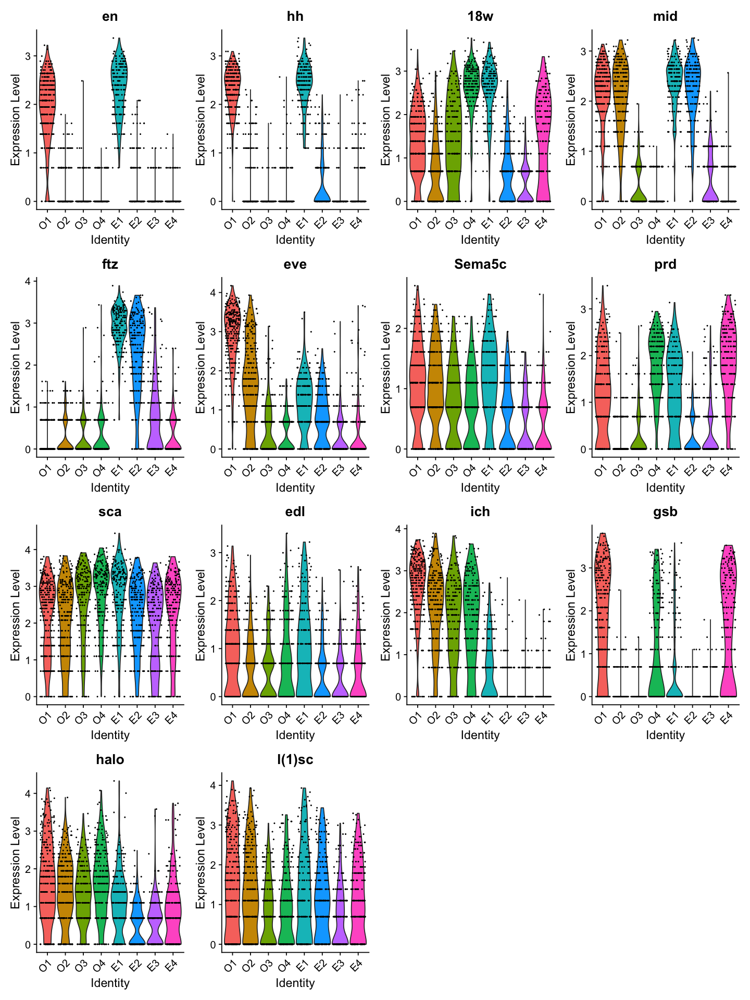

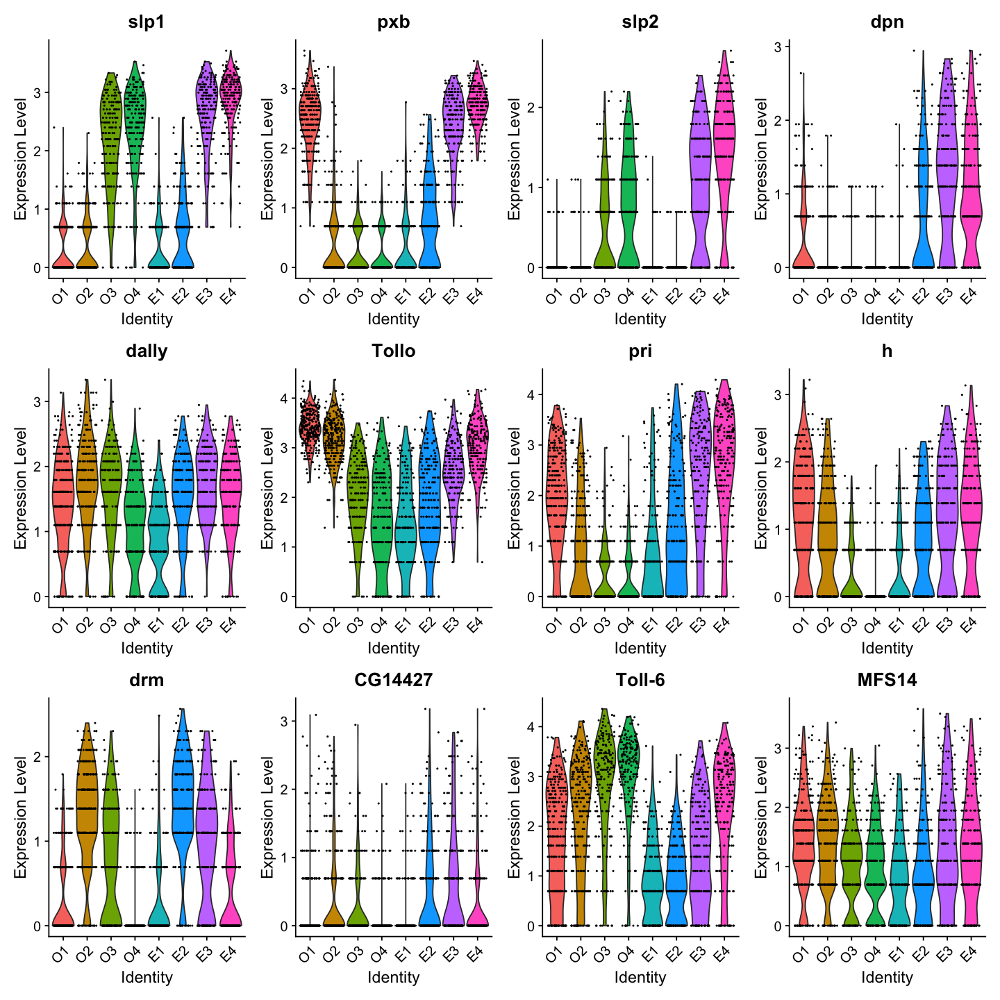

In [12]:
DE_E1vsE3 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E1",
  ident.2 = "E3",
  logfc.threshold = log(2.0),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E1vsE3_FWER0.01_FC2.0 <- filter(DE_E1vsE3, p_val_adj <= 0.01)

compaired_ID <- rep("E1vsE3", length=nrow(DE_E1vsE3_FWER0.01_FC2.0)) 
DE_E1vsE3_FWER0.01_FC2.0 <- cbind(DE_E1vsE3_FWER0.01_FC2.0, compaired_ID)
DE_E1vsE3_FWER0.01_FC2.0

DE_E1vsE3_FWER0.01_FC2.0_plus <- filter(DE_E1vsE3, p_val_adj <= 0.01 & avg_logFC >= log(2.0) )
DE_E1vsE3_FWER0.01_FC2.0_plus
dim(DE_E1vsE3_FWER0.01_FC2.0_plus)
DE_E1vsE3_FWER0.01_FC2.0_minus <- filter(DE_E1vsE3, p_val_adj <= 0.01 & avg_logFC <= -log(2.0) )
DE_E1vsE3_FWER0.01_FC2.0_minus
dim(DE_E1vsE3_FWER0.01_FC2.0_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E1vsE3_FWER0.01_FC2.0_plus)/4))
"DEGs E1vsE3, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E1vsE3_FWER0.01_FC2.0_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_E1vsE3_plus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E1vsE3_FWER0.01_FC2.0_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E1vsE3_FWER0.01_FC2.0_minus)/4))
"DEGs E1vsE3, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E1vsE3_FWER0.01_FC2.0_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_E1vsE3_minus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E1vsE3_FWER0.01_FC2.0_minus)/4))

write.table(DE_E1vsE3_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_E1vsE3_FWER0.01_FC2.0.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)


### E2 vs. E4


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
slp1,4.320555e-126,-2.1263088,0.542,1.000,8.641110e-123,E2vsE4
pxb,4.565284e-125,-1.7262565,0.635,1.000,9.130567e-122,E2vsE4
wg,2.676414e-114,-2.3027743,0.054,0.995,5.352828e-111,E2vsE4
mid,2.443409e-105,2.1058216,0.990,0.201,4.886818e-102,E2vsE4
odd,2.183822e-96,1.9153937,0.980,0.304,4.367644e-93,E2vsE4
slp2,6.870489e-79,-1.5771766,0.059,0.882,1.374098e-75,E2vsE4
ftz,2.937980e-74,2.0927048,0.936,0.353,5.875961e-71,E2vsE4
prd,1.463429e-69,-1.7459280,0.296,0.941,2.926859e-66,E2vsE4
Alh,2.297247e-56,-1.0818120,0.739,0.975,4.594494e-53,E2vsE4


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
mid,2.443409e-105,2.1058216,0.990,0.201,4.886818e-102
odd,2.183822e-96,1.9153937,0.980,0.304,4.367644e-93
ftz,2.937980e-74,2.0927048,0.936,0.353,5.875961e-71
trn,1.151927e-49,0.8226007,1.000,0.975,2.303854e-46
drm,2.358260e-46,0.9772844,0.921,0.456,4.716519e-43
sob,1.540303e-41,0.9318351,0.803,0.196,3.080606e-38
upd1,6.577557e-21,0.8295744,0.424,0.059,1.315511e-17
toc,3.164355e-16,1.1347788,0.571,0.250,6.328709e-13
chrb,4.188971e-12,0.7039401,0.749,0.436,8.377942e-09


[1] 9 5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,4.320555e-126,-2.1263088,0.542,1.000,8.641110e-123
pxb,4.565284e-125,-1.7262565,0.635,1.000,9.130567e-122
wg,2.676414e-114,-2.3027743,0.054,0.995,5.352828e-111
slp2,6.870489e-79,-1.5771766,0.059,0.882,1.374098e-75
prd,1.463429e-69,-1.7459280,0.296,0.941,2.926859e-66
Alh,2.297247e-56,-1.0818120,0.739,0.975,4.594494e-53
gsb,3.588818e-50,-2.1627166,0.074,0.691,7.177635e-47
Toll-6,2.137412e-42,-1.4463803,0.714,0.902,4.274824e-39
Tollo,6.398252e-42,-0.8938096,0.926,1.000,1.279650e-38


[1] 14  5

[1] "DEGs E2vsE4, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs E2vsE4, avgFC <= -1.5, FWER <= 0.01"

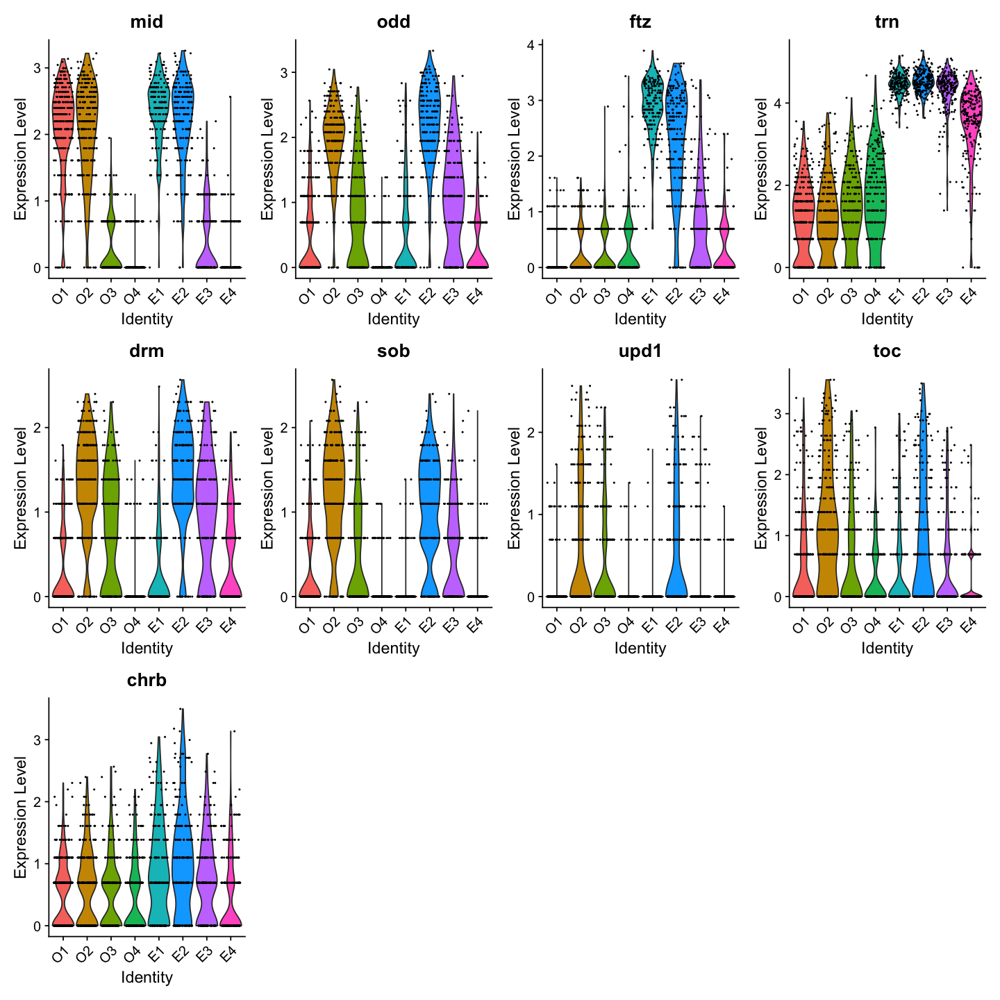

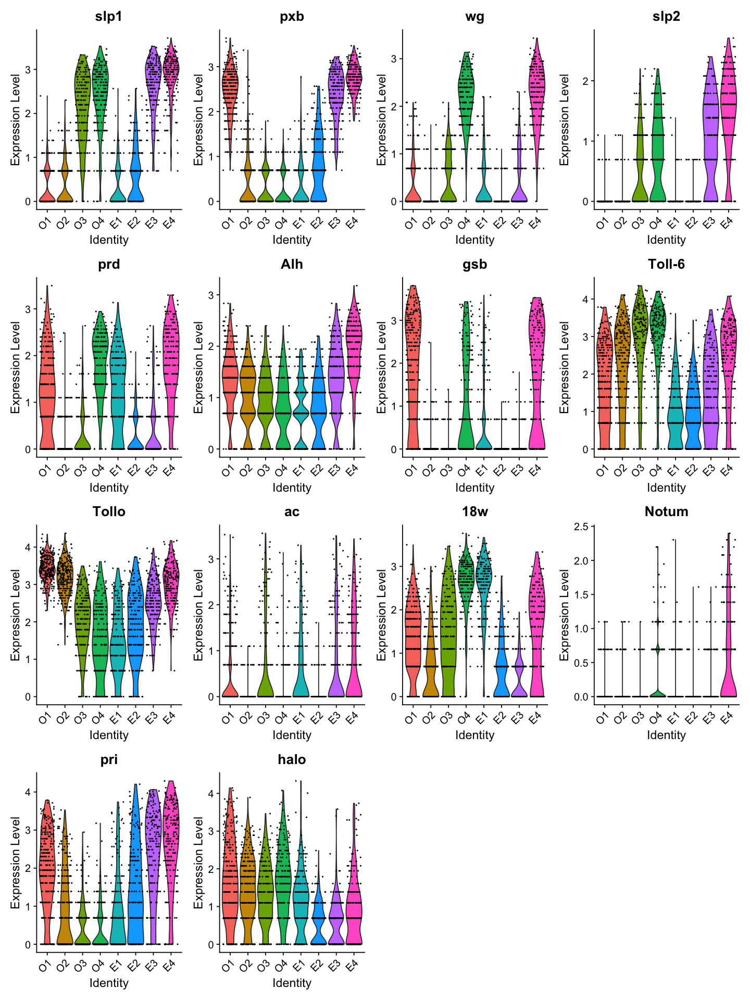

In [13]:
DE_E2vsE4 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E2",
  ident.2 = "E4",
  logfc.threshold = log(2.0),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E2vsE4_FWER0.01_FC2.0 <- filter(DE_E2vsE4, p_val_adj <= 0.01)

compaired_ID <- rep("E2vsE4", length=nrow(DE_E2vsE4_FWER0.01_FC2.0)) 
DE_E2vsE4_FWER0.01_FC2.0 <- cbind(DE_E2vsE4_FWER0.01_FC2.0, compaired_ID)
DE_E2vsE4_FWER0.01_FC2.0

DE_E2vsE4_FWER0.01_FC2.0_plus <- filter(DE_E2vsE4, p_val_adj <= 0.01 & avg_logFC >= log(2.0) )
DE_E2vsE4_FWER0.01_FC2.0_plus
dim(DE_E2vsE4_FWER0.01_FC2.0_plus)
DE_E2vsE4_FWER0.01_FC2.0_minus <- filter(DE_E2vsE4, p_val_adj <= 0.01 & avg_logFC <= -log(2.0) )
DE_E2vsE4_FWER0.01_FC2.0_minus
dim(DE_E2vsE4_FWER0.01_FC2.0_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E2vsE4_FWER0.01_FC2.0_plus)/4))
"DEGs E2vsE4, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E2vsE4_FWER0.01_FC2.0_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_E2vsE4_plus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E2vsE4_FWER0.01_FC2.0_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E2vsE4_FWER0.01_FC2.0_minus)/4))
"DEGs E2vsE4, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E2vsE4_FWER0.01_FC2.0_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_E2vsE4_minus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E2vsE4_FWER0.01_FC2.0_minus)/4))

write.table(DE_E2vsE4_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_E2vsE4_FWER0.01_FC2.0.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### E3 vs. O1


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
trn,5.686961e-180,2.8265645,1.000,0.751,1.137392e-176,E3vsO1
slp1,1.196292e-135,2.3822797,1.000,0.330,2.392584e-132,E3vsO1
hh,6.305359e-133,-2.2525026,0.062,0.996,1.261072e-129,E3vsO1
eve,7.863791e-123,-2.5260607,0.351,0.989,1.572758e-119,E3vsO1
ich,4.010316e-118,-2.5564066,0.191,0.954,8.020632e-115,E3vsO1
en,1.252064e-104,-1.9979968,0.098,0.944,2.504128e-101,E3vsO1
run,3.963546e-104,1.6332040,0.985,0.302,7.927092e-101,E3vsO1
mid,1.957407e-94,-1.6962504,0.397,0.965,3.914814e-91,E3vsO1
comm,6.140701e-79,1.4546954,0.948,0.253,1.228140e-75,E3vsO1


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
trn,5.686961e-180,2.8265645,1.000,0.751,1.137392e-176
slp1,1.196292e-135,2.3822797,1.000,0.330,2.392584e-132
run,3.963546e-104,1.6332040,0.985,0.302,7.927092e-101
comm,6.140701e-79,1.4546954,0.948,0.253,1.228140e-75
slp2,1.330272e-70,1.2089843,0.763,0.035,2.660543e-67
comm2,2.132256e-61,1.1512057,0.768,0.084,4.264512e-58
CG10479,1.746305e-43,1.0888689,0.912,0.656,3.492611e-40
CG15480,7.172972e-39,1.1201126,0.959,0.670,1.434594e-35
dpn,6.684510e-35,1.0484260,0.789,0.340,1.336902e-31


[1] 15  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
hh,6.305359e-133,-2.2525026,0.062,0.996,1.261072e-129
eve,7.863791e-123,-2.5260607,0.351,0.989,1.572758e-119
ich,4.010316e-118,-2.5564066,0.191,0.954,8.020632e-115
en,1.252064e-104,-1.9979968,0.098,0.944,2.504128e-101
mid,1.957407e-94,-1.6962504,0.397,0.965,3.914814e-91
rdx,7.977557e-69,-0.9300209,0.995,1.000,1.595511e-65
gsb,2.977588e-66,-2.2798155,0.113,0.814,5.955176e-63
Tollo,6.168222e-64,-0.7741319,1.000,1.000,1.233644e-60
18w,1.253839e-45,-1.1718360,0.418,0.898,2.507677e-42


[1] 16  5

[1] "DEGs E3vsO1, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs E3vsO1, avgFC <= -1.5, FWER <= 0.01"

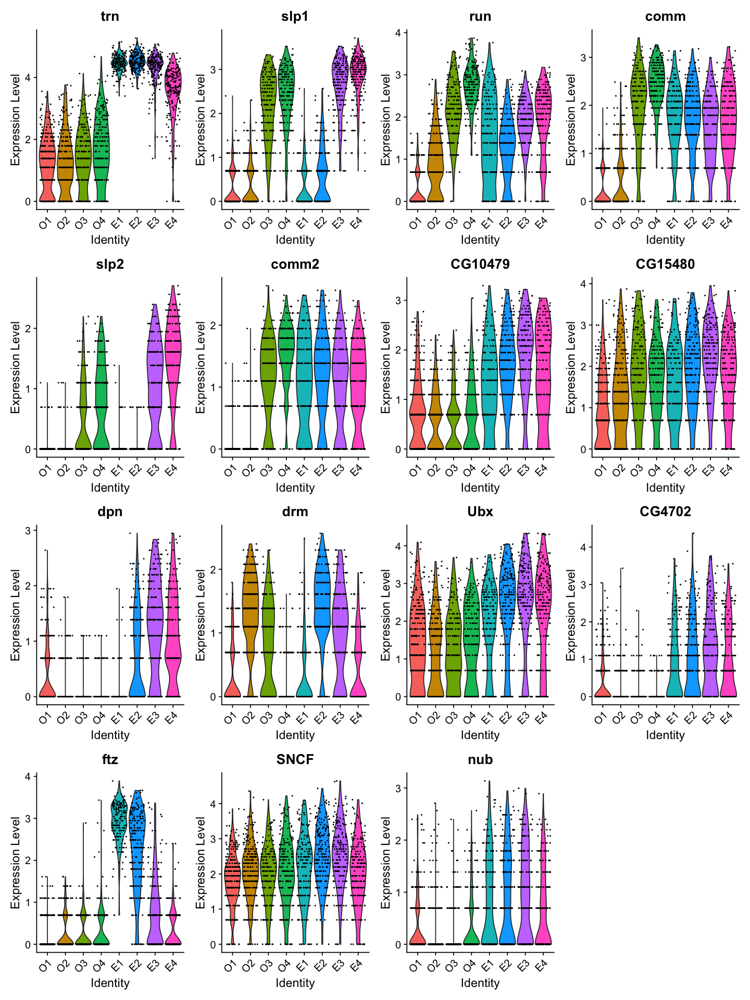

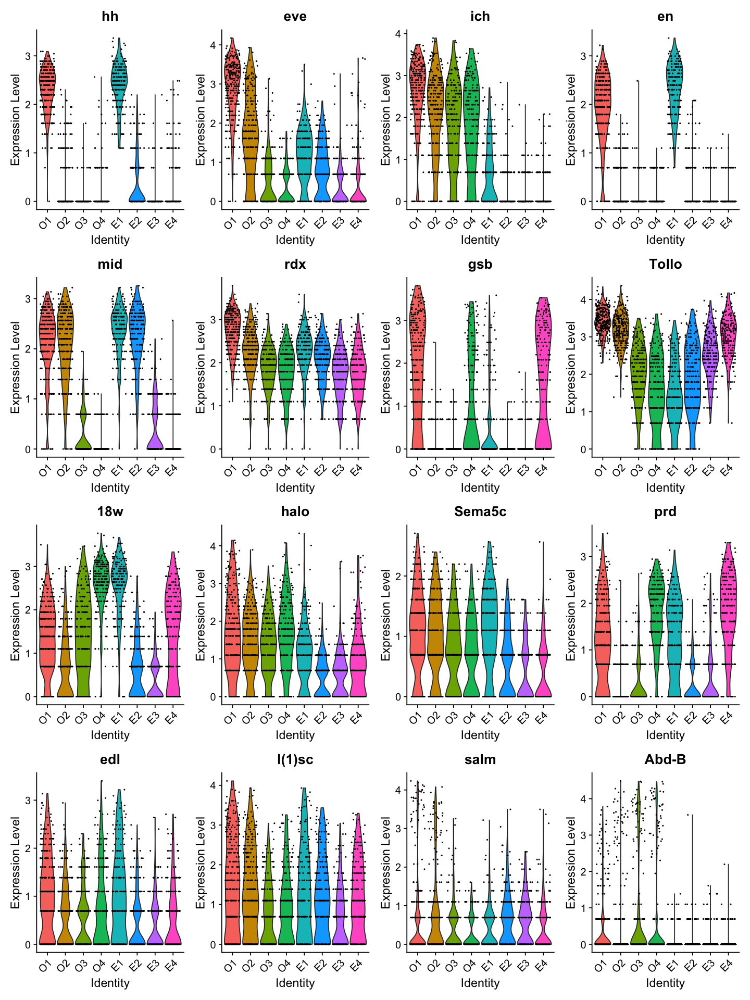

In [14]:
DE_E3vsO1 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E3",
  ident.2 = "O1",
  logfc.threshold = log(2.0),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E3vsO1_FWER0.01_FC2.0 <- filter(DE_E3vsO1, p_val_adj <= 0.01)

compaired_ID <- rep("E3vsO1", length=nrow(DE_E3vsO1_FWER0.01_FC2.0)) 
DE_E3vsO1_FWER0.01_FC2.0 <- cbind(DE_E3vsO1_FWER0.01_FC2.0, compaired_ID)
DE_E3vsO1_FWER0.01_FC2.0

DE_E3vsO1_FWER0.01_FC2.0_plus <- filter(DE_E3vsO1, p_val_adj <= 0.01 & avg_logFC >= log(2.0) )
DE_E3vsO1_FWER0.01_FC2.0_plus
dim(DE_E3vsO1_FWER0.01_FC2.0_plus)
DE_E3vsO1_FWER0.01_FC2.0_minus <- filter(DE_E3vsO1, p_val_adj <= 0.01 & avg_logFC <= -log(2.0) )
DE_E3vsO1_FWER0.01_FC2.0_minus
dim(DE_E3vsO1_FWER0.01_FC2.0_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E3vsO1_FWER0.01_FC2.0_plus)/4))
"DEGs E3vsO1, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E3vsO1_FWER0.01_FC2.0_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_E3vsO1_plus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E3vsO1_FWER0.01_FC2.0_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E3vsO1_FWER0.01_FC2.0_minus)/4))
"DEGs E3vsO1, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E3vsO1_FWER0.01_FC2.0_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_E3vsO1_minus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E3vsO1_FWER0.01_FC2.0_minus)/4))

write.table(DE_E3vsO1_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_E3vsO1_FWER0.01_FC2.0.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

### E4 vs. O2


Done!

Combining coefficients and standard errors

Calculating log-fold changes

Calculating likelihood ratio tests

Refitting on reduced model...


Done!



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
slp1,2.155980e-160,2.4707665,1.000,0.375,4.311960e-157,E4vsO2
pxb,7.469298e-155,2.0898043,1.000,0.402,1.493860e-151,E4vsO2
wg,1.059022e-123,2.2479730,0.995,0.069,2.118044e-120,E4vsO2
mid,5.076457e-103,-1.9862480,0.201,0.973,1.015291e-99,E4vsO2
odd,7.239954e-100,-1.6249148,0.304,0.973,1.447991e-96,E4vsO2
trn,2.719963e-96,2.0146648,0.975,0.808,5.439925e-93,E4vsO2
slp2,9.069878e-91,1.5787282,0.882,0.046,1.813976e-87,E4vsO2
prd,1.154782e-82,1.7872433,0.941,0.226,2.309563e-79,E4vsO2
ich,5.086089e-79,-2.0753224,0.230,0.931,1.017218e-75,E4vsO2


,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
slp1,2.155980e-160,2.4707665,1.000,0.375,4.311960e-157
pxb,7.469298e-155,2.0898043,1.000,0.402,1.493860e-151
wg,1.059022e-123,2.2479730,0.995,0.069,2.118044e-120
trn,2.719963e-96,2.0146648,0.975,0.808,5.439925e-93
slp2,9.069878e-91,1.5787282,0.882,0.046,1.813976e-87
prd,1.154782e-82,1.7872433,0.941,0.226,2.309563e-79
comm,2.786074e-57,1.2865409,0.951,0.406,5.572147e-54
gsb,4.090833e-53,2.0596211,0.691,0.123,8.181666e-50
comm2,7.275327e-50,0.9963641,0.794,0.157,1.455065e-46


[1] 20  5

,p_val,avg_logFC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
mid,5.076457e-103,-1.9862480,0.201,0.973,1.015291e-99
odd,7.239954e-100,-1.6249148,0.304,0.973,1.447991e-96
ich,5.086089e-79,-2.0753224,0.230,0.931,1.017218e-75
sob,7.243905e-64,-1.1531643,0.196,0.889,1.448781e-60
drm,4.986439e-44,-0.8753035,0.456,0.916,9.972879e-41
ImpL2,1.629196e-43,-1.0728297,0.966,0.996,3.258392e-40
eve,2.704255e-36,-1.2591861,0.328,0.835,5.408509e-33
toc,7.264117e-30,-1.3215539,0.250,0.724,1.452823e-26
upd1,1.931028e-22,-0.8749919,0.059,0.410,3.862056e-19


[1] 13  5

[1] "DEGs E4vsO2, avgFC >= 1.5, FWER <= 0.01"

[1] "DEGs E4vsO2, avgFC <= -1.5, FWER <= 0.01"

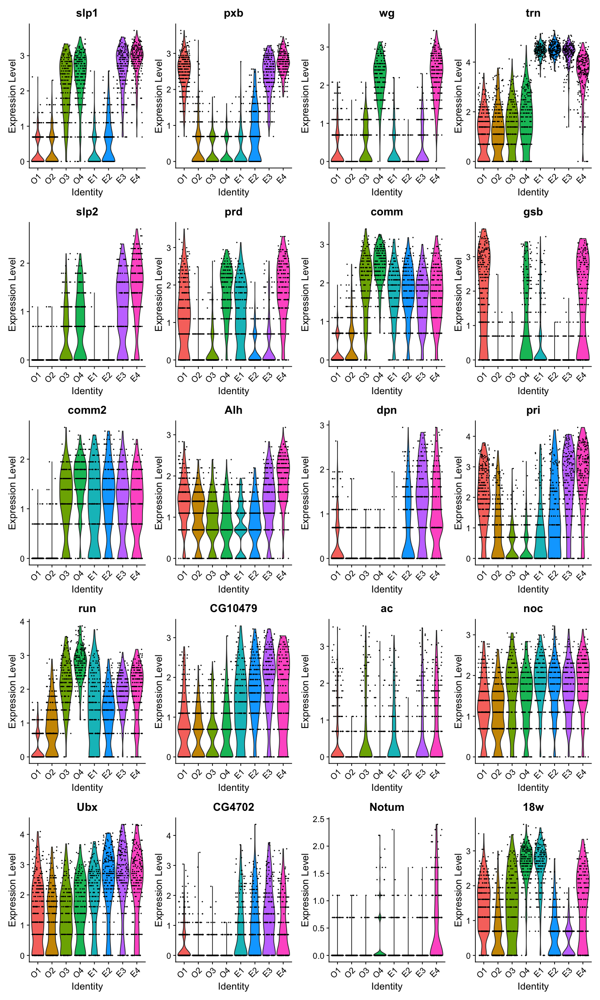

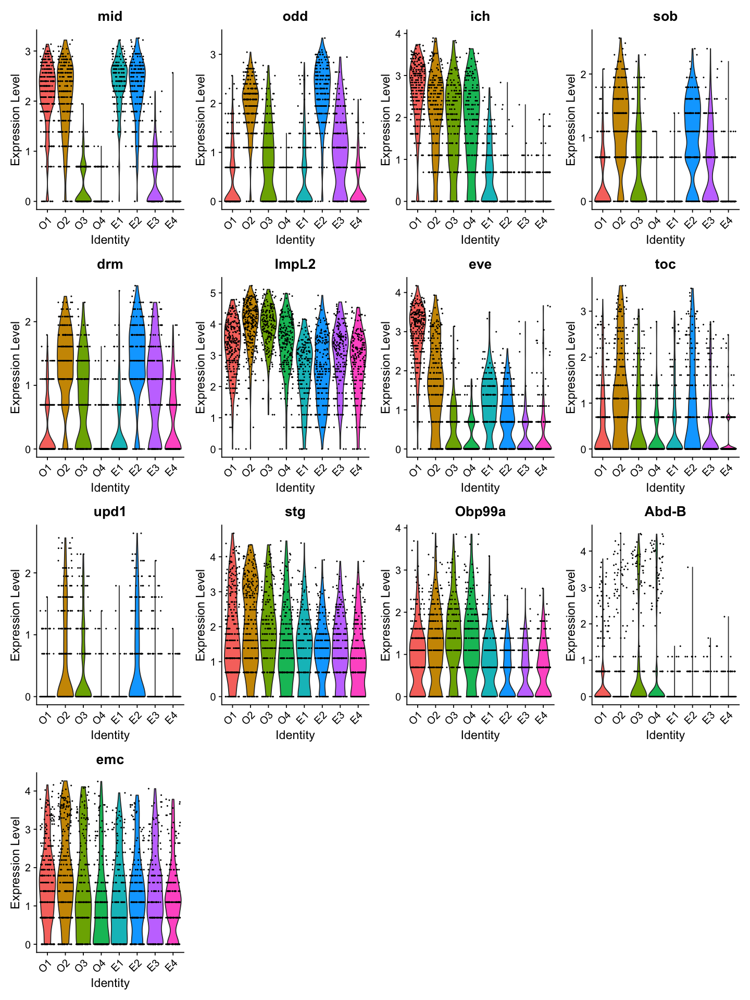

In [15]:
DE_E4vsO2 <- FindMarkers(
  seu_PR_VF3000,
  ident.1 = "E4",
  ident.2 = "O2",
  logfc.threshold = log(2.0),
  test.use = "MAST",
  verbose = TRUE,
  only.pos = FALSE,
)

DE_E4vsO2_FWER0.01_FC2.0 <- filter(DE_E4vsO2, p_val_adj <= 0.01)

compaired_ID <- rep("E4vsO2", length=nrow(DE_E4vsO2_FWER0.01_FC2.0)) 
DE_E4vsO2_FWER0.01_FC2.0 <- cbind(DE_E4vsO2_FWER0.01_FC2.0, compaired_ID)
DE_E4vsO2_FWER0.01_FC2.0

DE_E4vsO2_FWER0.01_FC2.0_plus <- filter(DE_E4vsO2, p_val_adj <= 0.01 & avg_logFC >= log(2.0) )
DE_E4vsO2_FWER0.01_FC2.0_plus
dim(DE_E4vsO2_FWER0.01_FC2.0_plus)
DE_E4vsO2_FWER0.01_FC2.0_minus <- filter(DE_E4vsO2, p_val_adj <= 0.01 & avg_logFC <= -log(2.0) )
DE_E4vsO2_FWER0.01_FC2.0_minus
dim(DE_E4vsO2_FWER0.01_FC2.0_minus)

options(repr.plot.width=12, repr.plot.height=　4*ceiling(nrow(DE_E4vsO2_FWER0.01_FC2.0_plus)/4))
"DEGs E4vsO2, avgFC >= 1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E4vsO2_FWER0.01_FC2.0_plus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_E4vsO2_plus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E4vsO2_FWER0.01_FC2.0_plus)/4))

options(repr.plot.width=12, repr.plot.height=4*ceiling(nrow(DE_E4vsO2_FWER0.01_FC2.0_minus)/4))
"DEGs E4vsO2, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = rownames(DE_E4vsO2_FWER0.01_FC2.0_minus), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_E4vsO2_minus_FC2.0.png", 
       width = 10.24, height = 2.56*ceiling(nrow(DE_E4vsO2_FWER0.01_FC2.0_minus)/4))

write.table(DE_E4vsO2_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_E4vsO2_FWER0.01_FC2.0.txt", 
            sep="\t", col.names=T, row.names=T, quote=F)

## Merge results

In [16]:
DE_O1vsO3_FWER0.01_FC2.0 <- DE_O1vsO3_FWER0.01_FC2.0 %>% rownames_to_column("gene_name")
DE_O2vsO4_FWER0.01_FC2.0 <- DE_O2vsO4_FWER0.01_FC2.0 %>% rownames_to_column("gene_name")
DE_O3vsE1_FWER0.01_FC2.0 <- DE_O3vsE1_FWER0.01_FC2.0 %>% rownames_to_column("gene_name")
DE_O4vsE2_FWER0.01_FC2.0 <- DE_O4vsE2_FWER0.01_FC2.0 %>% rownames_to_column("gene_name")
DE_E1vsE3_FWER0.01_FC2.0 <- DE_E1vsE3_FWER0.01_FC2.0 %>% rownames_to_column("gene_name")
DE_E2vsE4_FWER0.01_FC2.0 <- DE_E2vsE4_FWER0.01_FC2.0 %>% rownames_to_column("gene_name")
DE_E3vsO1_FWER0.01_FC2.0 <- DE_E3vsO1_FWER0.01_FC2.0 %>% rownames_to_column("gene_name")
DE_E4vsO2_FWER0.01_FC2.0 <- DE_E4vsO2_FWER0.01_FC2.0 %>% rownames_to_column("gene_name")
DE_all_FWER0.01_FC2.0 <- rbind(DE_O1vsO3_FWER0.01_FC2.0, DE_O2vsO4_FWER0.01_FC2.0, DE_O3vsE1_FWER0.01_FC2.0, 
                              DE_O4vsE2_FWER0.01_FC2.0, DE_E1vsE3_FWER0.01_FC2.0, DE_E2vsE4_FWER0.01_FC2.0,
                             DE_E3vsO1_FWER0.01_FC2.0, DE_E4vsO2_FWER0.01_FC2.0)

In [17]:
DE_all_FWER0.01_FC2.0

gene_name,p_val,avg_logFC,pct.1,pct.2,p_val_adj,compaired_ID
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
pxb,2.089813e-143,2.1899253,1.000,0.354,4.179627e-140,O1vsO3
hh,1.917854e-138,2.3203573,0.996,0.053,3.835708e-135,O1vsO3
eve,5.478680e-109,2.2680469,0.989,0.455,1.095736e-105,O1vsO3
mid,8.744809e-107,1.8990632,0.965,0.328,1.748962e-103,O1vsO3
run,8.007395e-105,-1.9959873,0.302,0.989,1.601479e-101,O1vsO3
en,2.683831e-100,1.9535365,0.944,0.095,5.367663e-97,O1vsO3
Tollo,2.850648e-98,1.1862407,1.000,0.963,5.701296e-95,O1vsO3
slp1,1.581620e-97,-1.9855340,0.330,0.979,3.163240e-94,O1vsO3
comm,9.041898e-90,-1.8895844,0.253,0.937,1.808380e-86,O1vsO3


In [18]:
table(DE_all_FWER0.01_FC2.0$compaired_ID)


E1vsE3 E2vsE4 E3vsO1 E4vsO2 O1vsO3 O2vsO4 O3vsE1 O4vsE2 
    26     23     31     33     23     22     22     30 

In [19]:
length(unique(DE_all_FWER0.01_FC2.0$gene_name))

[1] 63

In [20]:
write.table(DE_all_FWER0.01_FC2.0, file = "./DEG_superboundary_FC2.0/DEGs_all_FWER0.01_FC2.0_superboundary.txt", 
            sep="\t", col.names=T, row.names=F, quote=F)

In [21]:
write(unique(DE_all_FWER0.01_FC2.0$gene_name), file = "./DEG_superboundary_FC2.0/unique_DEGs_list_FWER0.01_FC2.0_superboundary.txt" )

[1] "DEGs all unique, avgFC <= -1.5, FWER <= 0.01"

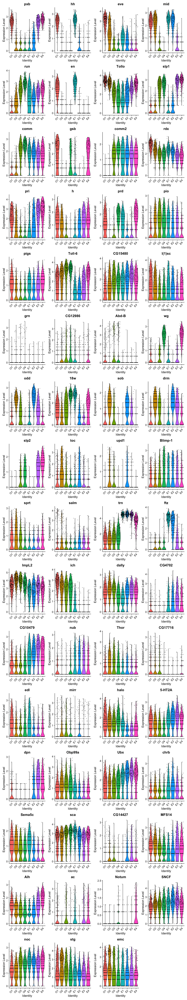

In [22]:
options(repr.plot.width=12, repr.plot.height=4*ceiling(length(unique(DE_all_FWER0.01_FC2.0$gene_name))/4))
"DEGs all unique, avgFC <= -1.5, FWER <= 0.01"
VlnPlot(seu_PR_VF3000, features = unique(DE_all_FWER0.01_FC2.0$gene_name), pt.size = 0.2, ncol = 4) 
ggsave(file = "./DEG_superboundary_FC2.0/DEGs_unique_all_FC2.0_superboundary.png", 
       width = 10.24, height = 2.56*ceiling(length(unique(DE_all_FWER0.01_FC2.0$gene_name))/4), limitsize = FALSE)

In [23]:
unique(DE_all_FWER0.01_FC2.0$gene_name)

[1] "pxb"     "hh"      "eve"     "mid"     "run"     "en"      "Tollo"  
 [8] "slp1"    "comm"    "gsb"     "comm2"   "rdx"     "pri"     "h"      
[15] "prd"     "pio"     "pigs"    "Toll-6"  "CG15480" "l(1)sc"  "grn"    
[22] "CG12986" "Abd-B"   "wg"      "odd"     "18w"     "sob"     "drm"    
[29] "slp2"    "toc"     "upd1"    "Blimp-1" "sprt"    "salm"    "trn"    
[36] "ftz"     "ImpL2"   "ich"     "dally"   "CG4702"  "CG10479" "nub"    
[43] "Thor"    "CG17716" "edl"     "mirr"    "halo"    "5-HT2A"  "dpn"    
[50] "Obp99a"  "Ubx"     "chrb"    "Sema5c"  "sca"     "CG14427" "MFS14"  
[57] "Alh"     "ac"      "Notum"   "SNCF"    "noc"     "stg"     "emc"

In [24]:
options(repr.plot.width=3, repr.plot.height=4)
for (i in unique(DE_all_FWER0.01_FC2.0$gene_name)){
plot <- VlnPlot(seu_PR_VF3000, features = paste(i), pt.size = 0.2, ncol = 1)  + 
scale_fill_manual(values = c("skyblue1", "skyblue2", "skyblue3", "skyblue4", "magenta1", "magenta2", "magenta3", "magenta4")) +
NoLegend()
ggsave(filename=paste("./DEG_superboundary_FC2.0/unique_plot/DEGs_unique_all_FC2.0_",i,".png", sep=""), 
       width = 3.84, height = 5.12, limitsize = FALSE)
}



In [26]:
sessionInfo()

R version 4.0.3 (2020-10-10)
Platform: x86_64-apple-darwin17.0 (64-bit)
Running under: macOS Catalina 10.15.7

Matrix products: default
BLAS:   /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRblas.dylib
LAPACK: /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRlapack.dylib

locale:
[1] ja_JP.UTF-8/ja_JP.UTF-8/ja_JP.UTF-8/C/ja_JP.UTF-8/ja_JP.UTF-8

attached base packages:
[1] parallel  stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] MAST_1.16.0                 SingleCellExperiment_1.12.0
 [3] SummarizedExperiment_1.20.0 Biobase_2.50.0             
 [5] GenomicRanges_1.42.0        GenomeInfoDb_1.26.2        
 [7] IRanges_2.24.1              S4Vectors_0.28.1           
 [9] BiocGenerics_0.36.0         MatrixGenerics_1.2.0       
[11] matrixStats_0.57.0          tibble_3.0.5               
[13] dplyr_1.0.3                 Matrix_1.3-2               
[15] data.table_1.13.6           magrittr_2.0.1